# Data dictionary

* Variable Name = Description
* age =	Age
* job =	Type of job
* marital =	Marital status
* education = Level of education
* default =	Has credit in default
* housing =	Has a housing loan
* loan = Has a personal loan
* contact =	Contact communication type
* day_of_week =	Day of contact
* month = Month of contact
* duration = Last contact duration, in seconds (numeric). Important note:  this attribute highly affects the output target (e.g., if duration=0 then y="no"). Yet, the duration is not known before a call is performed. Also, after the end of the call y is obviously known.
* campaign = Number of contacts performed during this campaign and for this client
* pdays = Number of days that passed by after the client was last contacted from a previous campaign (numeric, -1 means client was not previously contacted)
* previous = Number of contacts performed before this campaign and for this client 
* poutcome = Outcome of the previous marketing campaign
* emp.var.rate = employment variation rate - quarterly indicator (numeric)
* cons.price.idx = consumer price index - monthly indicator (numeric)    
* cons.conf.idx = consumer confidence index - monthly indicator (numeric) 
* euribor3m = euribor 3 month rate - daily indicator (numeric)
* nr.employed = number employed - quarterly indicator (numeric)
* y = Did the client subscribe to a Telecom plan?


# Exploratory Data Analysis

* Step 1: Import data

* Step 2: Collect initial  data

* Step 3: Describe data

* Step 4: Verify data quality

* Step 5: Explore data
    * Step 5.1: Summary Statistics 
    * Step 5.2: Identifying  Outliers 
    * Step 5.3: Relationship Between Variables  

(Hotz, 2023)

## Step 1 - Import data

In [94]:
# Import library for reading .csv files
import pandas as pd # Data analysis and manipulation library
import re # Module used for string searching and manipulation
import io # Module used for reading and writing data

# (GeeksforGeeks, 2022)

In [95]:
# Read the CSV file
with open('TeleCom_Data-1.csv', 'r') as file:
    csv_text = file.read()

# Define the separator
separator = ';'

# Handle special symbols to split in the csv into seperate columns using regular expressions
csv_text = re.sub(r'";', separator, csv_text)
csv_text = re.sub(r';"', separator, csv_text)
csv_text = re.sub(r'";"', separator, csv_text)

# Convert the csv into a dataframe using pandas
df = pd.read_csv(io.StringIO(csv_text), sep=separator)

# Display the first few rows of the dataframe
df.head()

#(Grabbing CSV Information With Regex in Python, n.d.) 

,age;job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,"y"""""""
0,40;admin.,married,basic.6y,no,no,no,telephone,may,"mon""",151,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,"no"""
1,56;services,married,high.school,no,no,yes,telephone,may,"mon""",307,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,"no"""
2,45;services,married,basic.9y,unknown,no,no,telephone,may,"mon""",198,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,"no"""
3,59;admin.,married,professional.course,no,no,no,telephone,may,"mon""",139,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,"no"""
4,41;blue-collar,married,unknown,unknown,no,no,telephone,may,"mon""",217,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,"no"""


In [96]:
# Split the 'age;job' column into two separate columns: 'age' and 'job'
df[['age', 'job']] = df["age;job"].str.split(';', expand=True)

# Drop the original 'age;job' column
df.drop(columns='age;job', inplace=True)

df.head()

,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,...,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,"y""""""",age,job
0,married,basic.6y,no,no,no,telephone,may,"mon""",151,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,"no""",40,admin.
1,married,high.school,no,no,yes,telephone,may,"mon""",307,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,"no""",56,services
2,married,basic.9y,unknown,no,no,telephone,may,"mon""",198,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,"no""",45,services
3,married,professional.course,no,no,no,telephone,may,"mon""",139,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,"no""",59,admin.
4,married,unknown,unknown,no,no,telephone,may,"mon""",217,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,"no""",41,blue-collar


In [97]:
# Get rid of the special symbols on rows in certain columns
df['y"""'] = df['y"""'].str.replace('"', "")
df['day_of_week'] = df['day_of_week'].str.replace('"', "")
df.head()

,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,...,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,"y""""""",age,job
0,married,basic.6y,no,no,no,telephone,may,mon,151,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,40,admin.
1,married,high.school,no,no,yes,telephone,may,mon,307,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,56,services
2,married,basic.9y,unknown,no,no,telephone,may,mon,198,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,45,services
3,married,professional.course,no,no,no,telephone,may,mon,139,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,59,admin.
4,married,unknown,unknown,no,no,telephone,may,mon,217,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,41,blue-collar


In [98]:
# Rename the target variable column to get rid of special symbols
df.rename(columns={'y"""': 'y'}, inplace=True)
df.head()

,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,...,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,age,job
0,married,basic.6y,no,no,no,telephone,may,mon,151,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,40,admin.
1,married,high.school,no,no,yes,telephone,may,mon,307,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,56,services
2,married,basic.9y,unknown,no,no,telephone,may,mon,198,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,45,services
3,married,professional.course,no,no,no,telephone,may,mon,139,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,59,admin.
4,married,unknown,unknown,no,no,telephone,may,mon,217,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,41,blue-collar


## Step 2 - Collect inital data

In [99]:
# Display the shape and first 5 rows of the data
print(df.shape)
df.head()

(41180, 21)


,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,...,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,age,job
0,married,basic.6y,no,no,no,telephone,may,mon,151,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,40,admin.
1,married,high.school,no,no,yes,telephone,may,mon,307,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,56,services
2,married,basic.9y,unknown,no,no,telephone,may,mon,198,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,45,services
3,married,professional.course,no,no,no,telephone,may,mon,139,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,59,admin.
4,married,unknown,unknown,no,no,telephone,may,mon,217,1,...,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,41,blue-collar


In [100]:
# Look at 5 random rows of the data
df.sample(5)

,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,...,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,age,job
12604,married,professional.course,no,no,no,cellular,jul,mon,167,2,...,0,nonexistent,1.4,93.918,-42.7,4.960,5228.1,no,32,technician
32038,married,basic.9y,no,no,no,cellular,may,thu,369,1,...,0,nonexistent,-1.8,92.893,-46.2,1.327,5099.1,no,56,blue-collar
17570,single,university.degree,unknown,no,no,cellular,jul,mon,644,3,...,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no,39,technician
22989,married,university.degree,no,no,no,cellular,aug,mon,98,3,...,0,nonexistent,1.4,93.444,-36.1,4.965,5228.1,no,50,admin.
39122,married,high.school,no,yes,no,cellular,dec,wed,158,3,...,0,nonexistent,-3.0,92.713,-33.0,0.700,5023.5,no,31,student


## Step 3 - Describe data

In [101]:
# Check how many rows and columns, how many non-null values and datatype of the datasets
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41180 entries, 0 to 41179
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   marital         41180 non-null  object 
 1   education       41180 non-null  object 
 2   default         41180 non-null  object 
 3   housing         41180 non-null  object 
 4   loan            41180 non-null  object 
 5   contact         41180 non-null  object 
 6   month           41180 non-null  object 
 7   day_of_week     41180 non-null  object 
 8   duration        41180 non-null  int64  
 9   campaign        41180 non-null  int64  
 10  pdays           41180 non-null  int64  
 11  previous        41180 non-null  int64  
 12  poutcome        41180 non-null  object 
 13  emp.var.rate    41180 non-null  float64
 14  cons.price.idx  41180 non-null  float64
 15  cons.conf.idx   41180 non-null  float64
 16  euribor3m       41180 non-null  float64
 17  nr.employed     41180 non-null 

In [102]:
# Get a quick statistical overview of the data
df.describe()

,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
count,41180.000000,41180.000000,41180.000000,41180.000000,41180.000000,41180.000000,41180.000000,41180.000000,41180.000000
mean,258.280427,2.567800,962.516707,0.172705,0.081901,93.575508,-40.501999,3.621422,5167.053344
std,259.299856,2.770225,186.809028,0.493719,1.571037,0.578762,4.627358,1.734385,72.230334
min,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000
25%,102.000000,1.000000,999.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000
50%,180.000000,2.000000,999.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000
75%,319.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000
max,4918.000000,56.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000


In [103]:
# Check distribution of target variable
df['y'].value_counts()

no     36542
yes     4638
Name: y, dtype: int64

## Step 4 - Verify data quality

In [104]:
# Check for missing values to be sure
df.isnull().sum()

marital           0
education         0
default           0
housing           0
loan              0
contact           0
month             0
day_of_week       0
duration          0
campaign          0
pdays             0
previous          0
poutcome          0
emp.var.rate      0
cons.price.idx    0
cons.conf.idx     0
euribor3m         0
nr.employed       0
y                 0
age               0
job               0
dtype: int64

In [105]:
# Check for duplicates
df.duplicated().sum()

12

In [106]:
# Group together and compare the duplicate and their original counterpart
duplicated_groups = df.groupby(list(df.columns)).filter(lambda x: len(x) > 1)
print(duplicated_groups)
# (So, 2023)

        marital            education  default housing loan    contact month  \
1261    married             basic.6y       no      no   no  telephone   may   
1262    married             basic.6y       no      no   no  telephone   may   
12256   married              unknown       no      no   no  telephone   jul   
12257   married              unknown       no      no   no  telephone   jul   
14151    single  professional.course       no      no   no   cellular   jul   
14230    single  professional.course       no      no   no   cellular   jul   
16815  divorced          high.school       no     yes   no   cellular   jul   
16952  divorced          high.school       no     yes   no   cellular   jul   
18460    single  professional.course       no     yes   no   cellular   jul   
18461    single  professional.course       no     yes   no   cellular   jul   
20068   married          high.school  unknown      no   no   cellular   aug   
20212   married          high.school  unknown      n

In [107]:
# Remove the duplicate rows while keeping the first occurence
df = df.drop_duplicates()

In [108]:
# Verify duplicates are removed
print(df.duplicated().sum())  # Should return 0 now


0


## Step 5 - Explore data

### Step 5.1 - Summary statistics 

In [109]:
# General Summary
summary_df = df.describe(include='all').transpose()

# Display Summary
print(summary_df)

#(So, 2023)

                  count unique                top   freq         mean  \
marital           41168      4            married  24914          NaN   
education         41168      8  university.degree  12162          NaN   
default           41168      3                 no  32570          NaN   
housing           41168      3                yes  21566          NaN   
loan              41168      3                 no  33931          NaN   
contact           41168      2           cellular  26131          NaN   
month             41168     10                may  13763          NaN   
day_of_week       41168      5                thu   8617          NaN   
duration        41168.0    NaN                NaN    NaN   258.311237   
campaign        41168.0    NaN                NaN    NaN     2.568087   
pdays           41168.0    NaN                NaN    NaN   962.506073   
previous        41168.0    NaN                NaN    NaN     0.172756   
poutcome          41168      3        nonexistent  

  0%|                                                                                         | 0/2756 [00:00<…

C:\Users\ans_b\anaconda3\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\ans_b\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\ans_b\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))


Telecom Data EDA
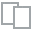
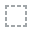
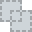
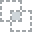
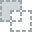
...
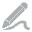
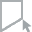
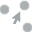
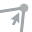
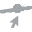

In [110]:
import dataprep  # Library used to simplify data preparation
from dataprep.eda import create_report # Function from dataprep used for exploratory data analysis
# Data Profiling using dataprep
report = create_report(df, title="Telecom Data EDA")
display(report)

#(Dong, 2023)
#(Dataprep.eda Inside Google Colab, n.d.) 

### Key findings from 5.1 Summary statistics

Key insights:
* Most individuals are married with a university degree.
* Most fields like Default, Housing, and Loan typically have the answer 'no'.
* Cellular contact was predominant, especially in May.
* Thursday was a slightly more common contact day.
* Most customers had not participated in a prior marketing campaign.
* A majority did not subscribe to the Telecom plan.
* Admin was the popular job category.

Potential problems to solve:
* Skewed variable: A lot of variables distribution is not symmetric, not ideal for an potential modeling phase. Especially the feature 'pdays'
* High cardinality: The feature 'age' has high cardinality with 78 unique values.


#### Actions taken after key findings from 5.1 Summary statistics

In [111]:
# Take a quick look at the 'pdays' feature
unique_values = df['pdays'].unique()
print(sorted(unique_values))


[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 25, 26, 27, 999]


In [112]:
# Transform pdays into contacted_recently
df['contacted_recently'] = df['pdays'].apply(lambda x: 0 if x == 999 else 1)

# Drop the original 'pdays' column
df.drop('pdays', axis=1, inplace=True)

# (So, 2023)

In [113]:
# Take a look at the new feature
df['contacted_recently'].value_counts()

0    39655
1     1513
Name: contacted_recently, dtype: int64

In [114]:
# Take a quick look at the age feature
unique_values = df['age'].unique()
print(sorted(unique_values))


['17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71', '72', '73', '74', '75', '76', '77', '78', '79', '80', '81', '82', '83', '84', '85', '86', '87', '88', '89', '91', '92', '94', '95', '98']


In [115]:
# Define function to bin ages
def age_bins(age):
    age = int(age)  # Convert string age to integer
    if 17 <= age <= 30:
        return 'Young'
    elif 31 <= age <= 45:
        return 'Young Adult'
    elif 46 <= age <= 60:
        return 'Middle Age'
    elif 61 <= age <= 75:
        return 'Senior'
    else:
        return 'Elderly'

# Apply the function to the 'age' column
df['age_group'] = df['age'].apply(age_bins)

# Drop the original 'age' column
df.drop('age', axis=1, inplace=True)
# (How to Use if Else Statement in Python to Bin a Variable, n.d.)

In [116]:
# Take a look at the new feature
df['age_group'].value_counts()

Young Adult    21964
Middle Age     10916
Young           7381
Senior           662
Elderly          245
Name: age_group, dtype: int64

#### Visualisations for 5.1 Summary statistics

In [117]:
# Prepare the data for exploration
# Convert target variable 'y' to binary format for correlation.
df['y_binary'] = df['y'].apply(lambda x: 1 if x == 'yes' else 0)

# Identify the categorical and numerical columns.
categorical_columns = df.select_dtypes(include=['object']).columns.drop('y')
numerical_columns = df.select_dtypes(exclude=['object']).columns.drop('y_binary')

# (So, 2023)

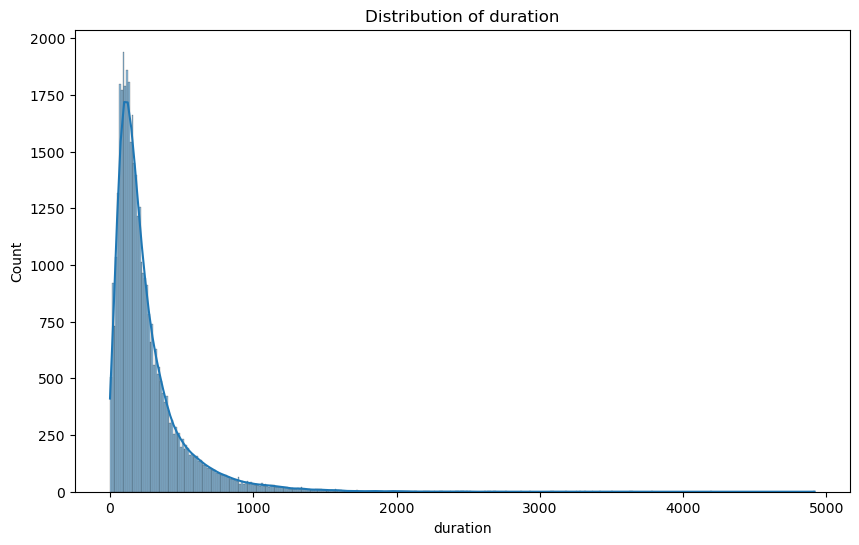

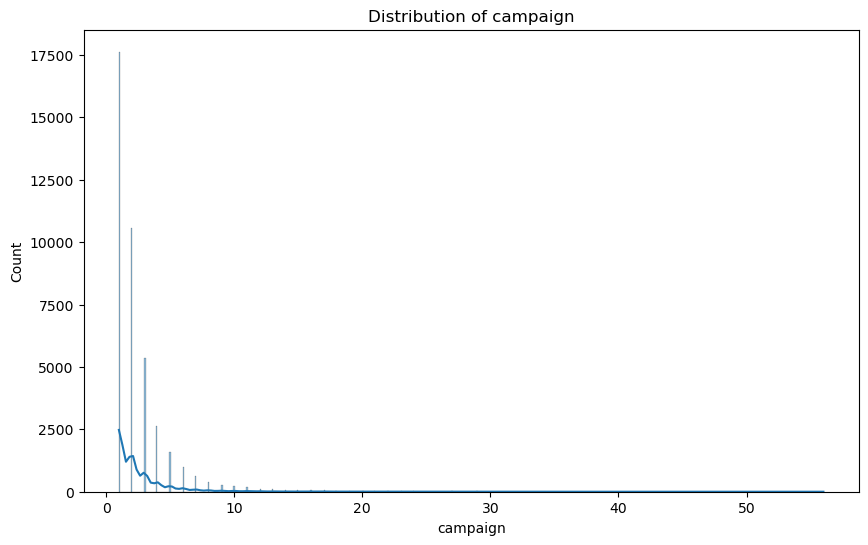

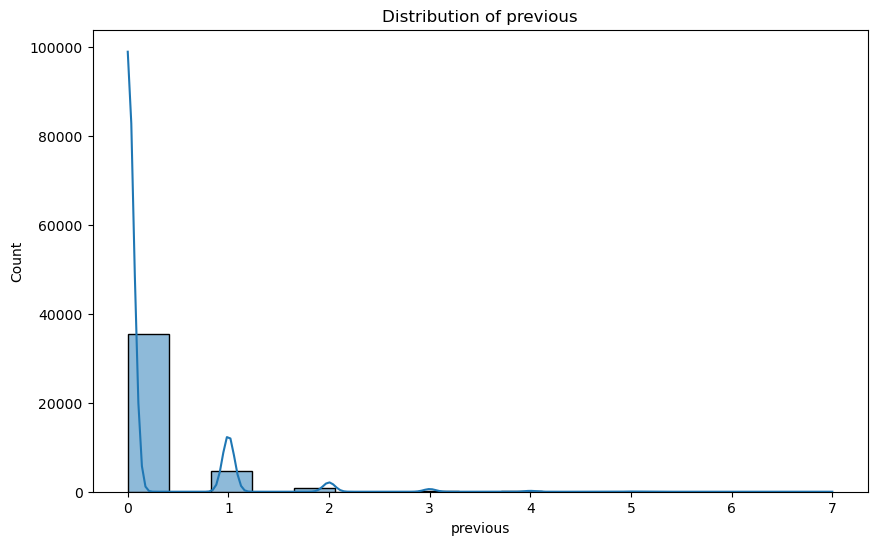

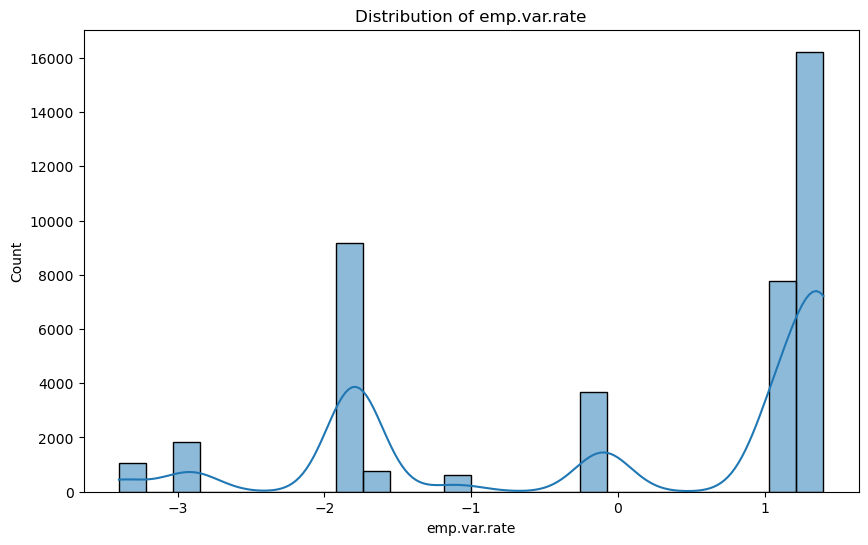

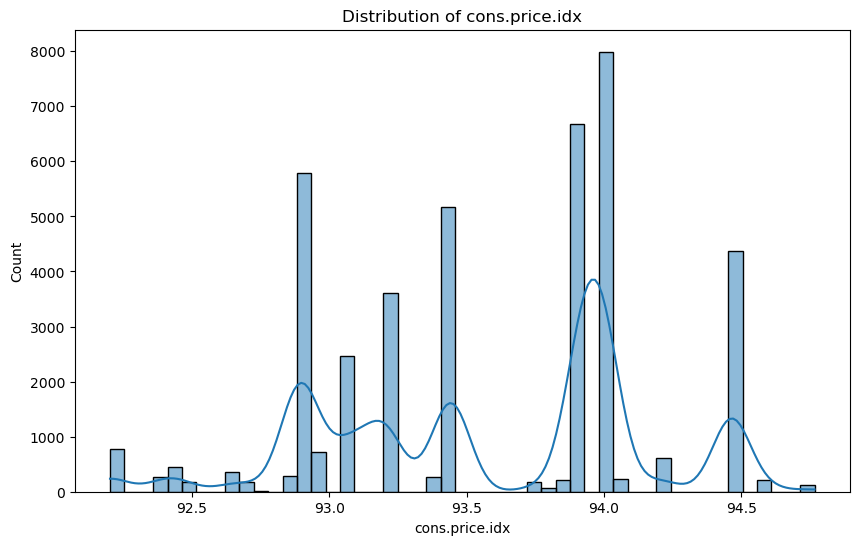

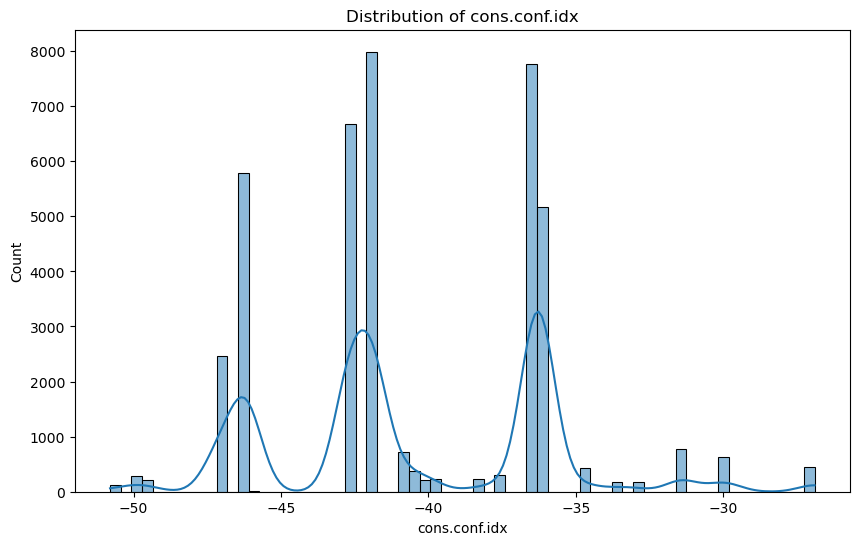

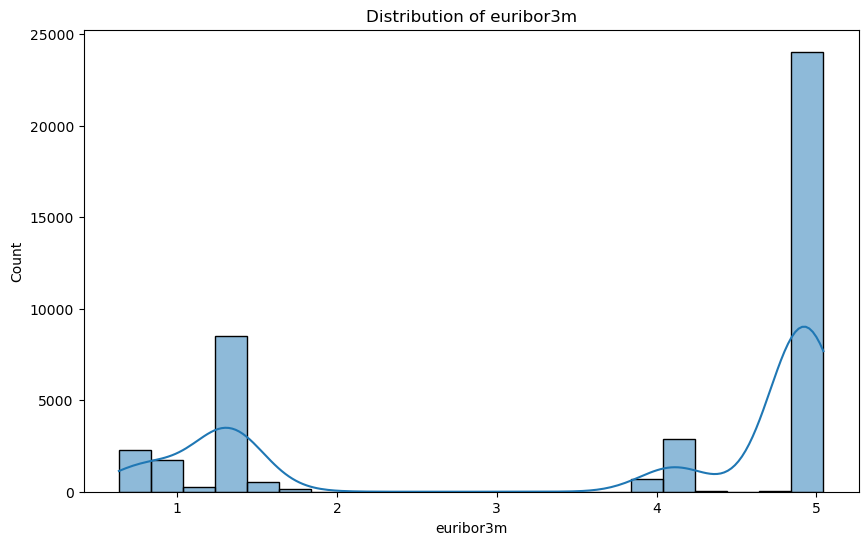

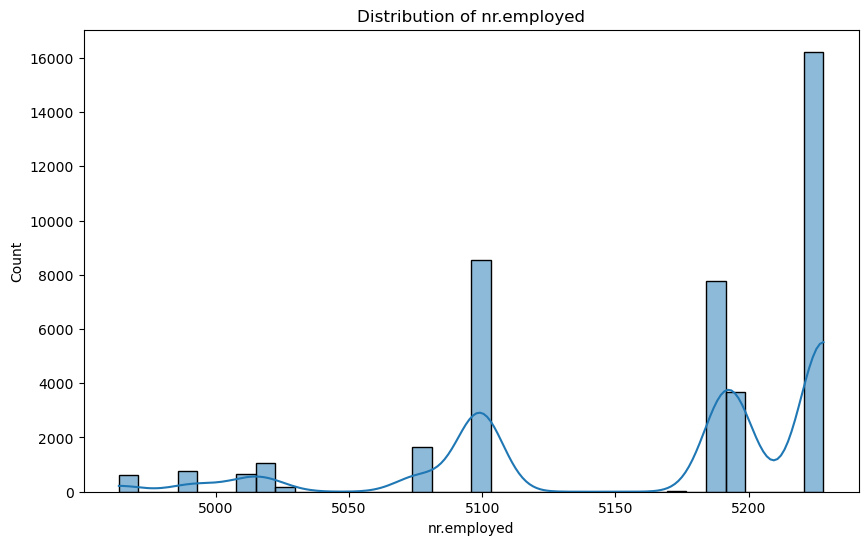

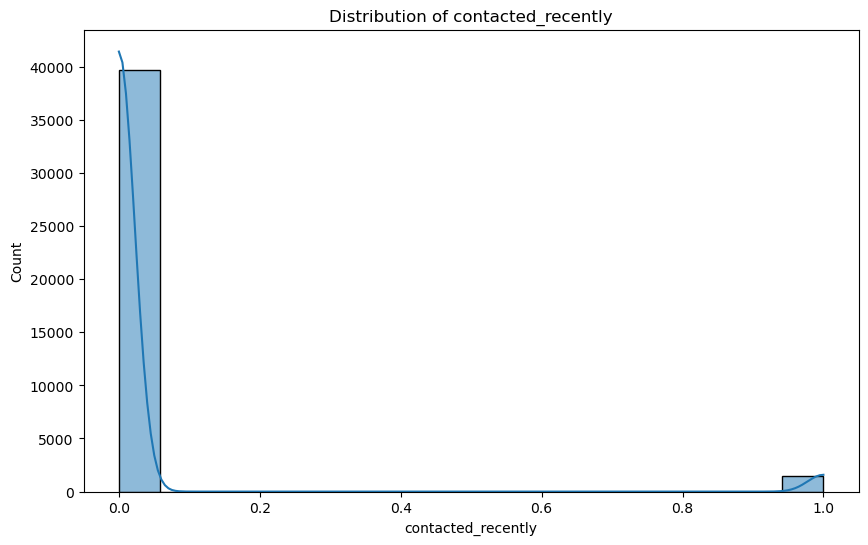

In [118]:
# Import libraries used for visualisation
import matplotlib.pyplot as plt
import seaborn as sns

# Visualisation of the distribution of the numerical features
for col in numerical_columns:
    plt.figure(figsize=(10, 6))
    sns.histplot(df[col], kde=True)
    plt.title(f'Distribution of {col}')
    plt.show()

# (So, 2023)

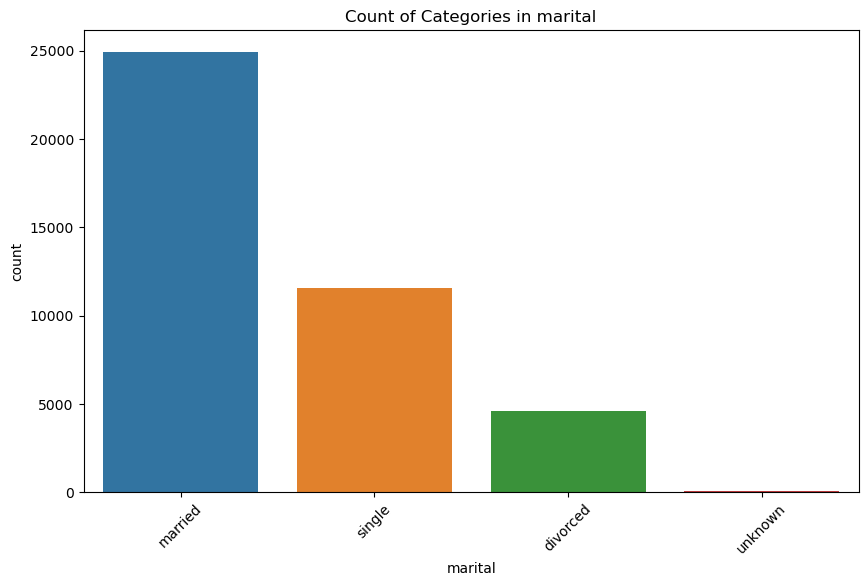

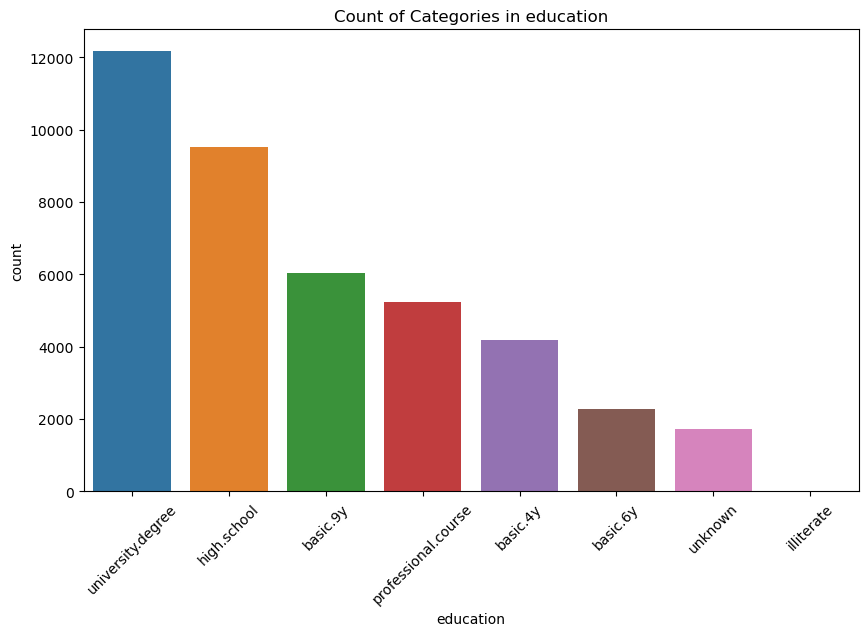

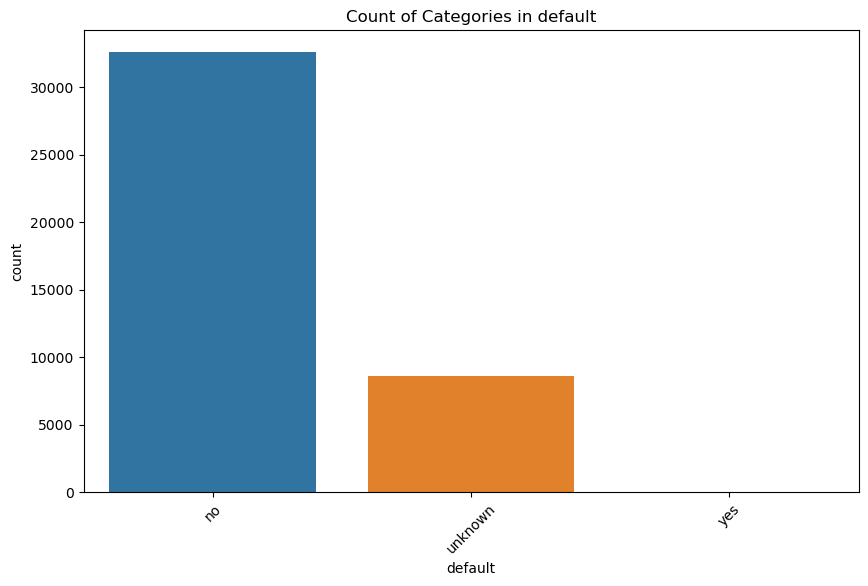

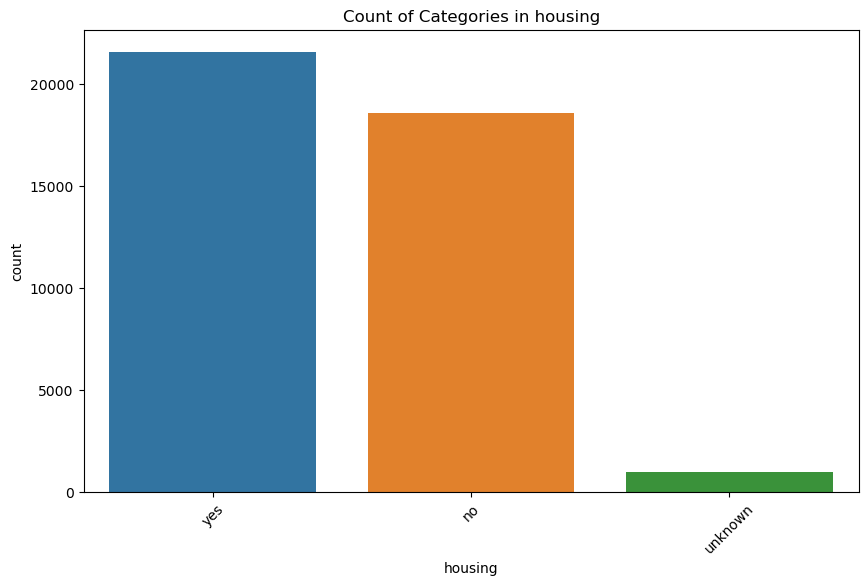

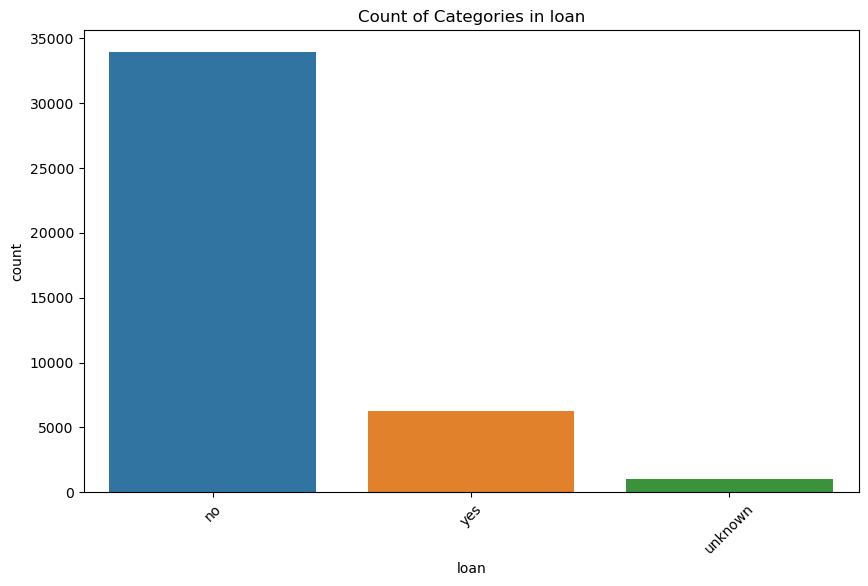

...

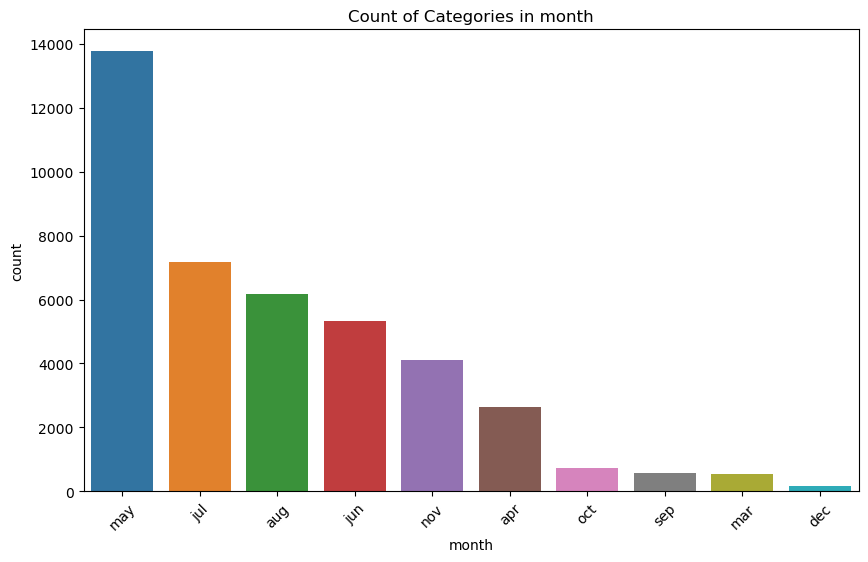

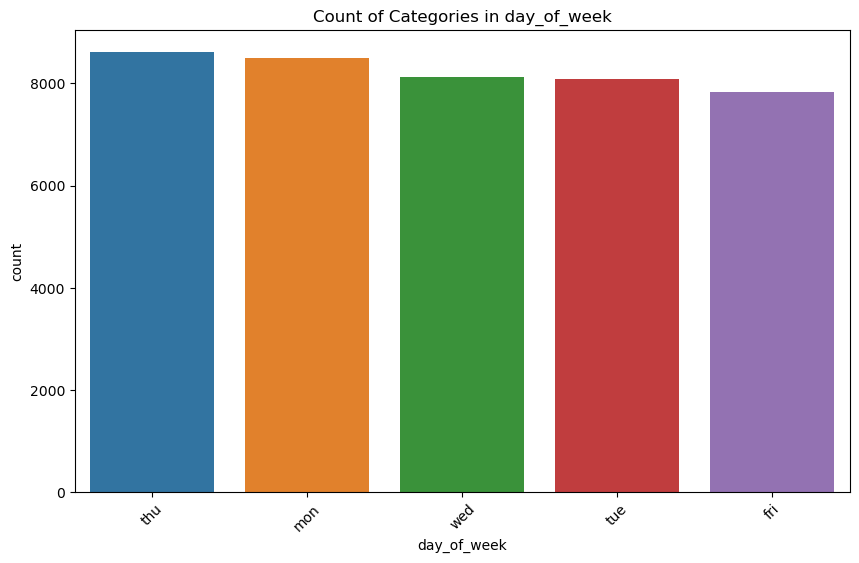

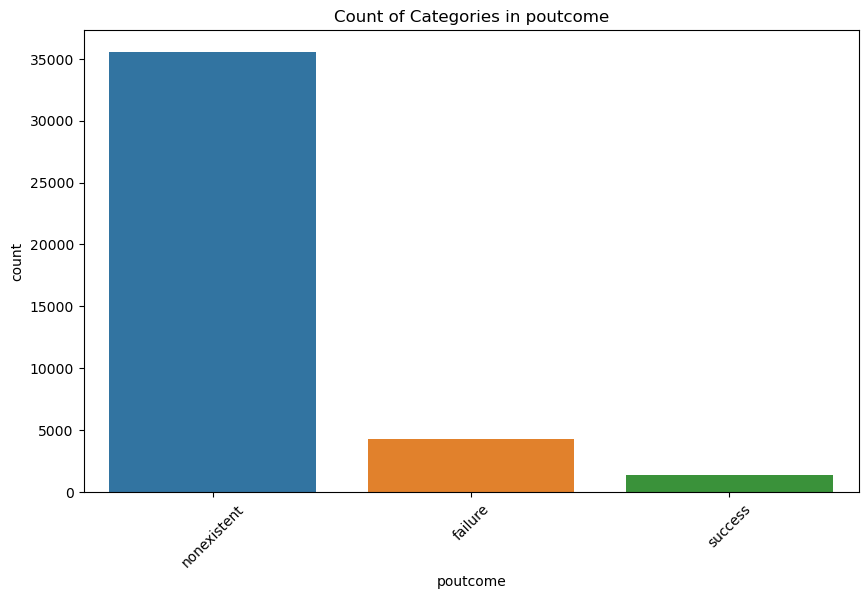

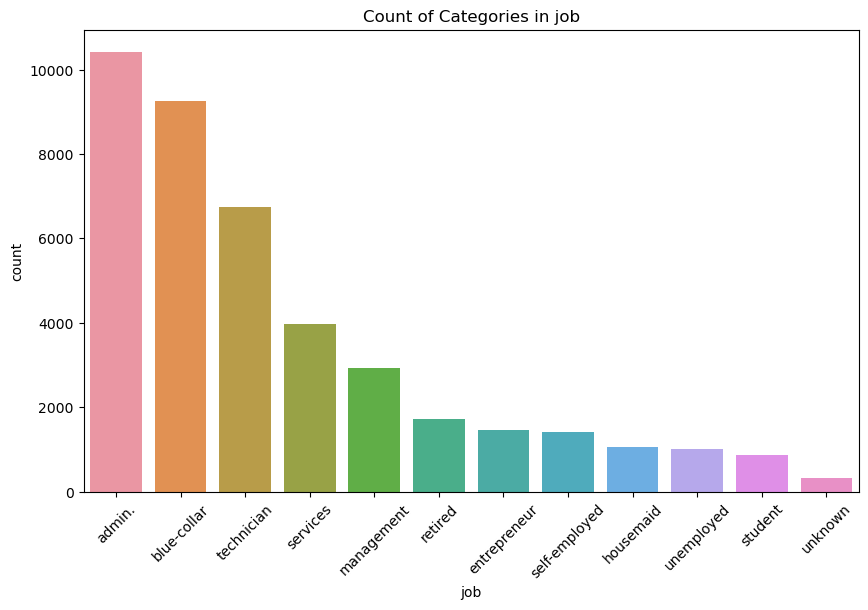

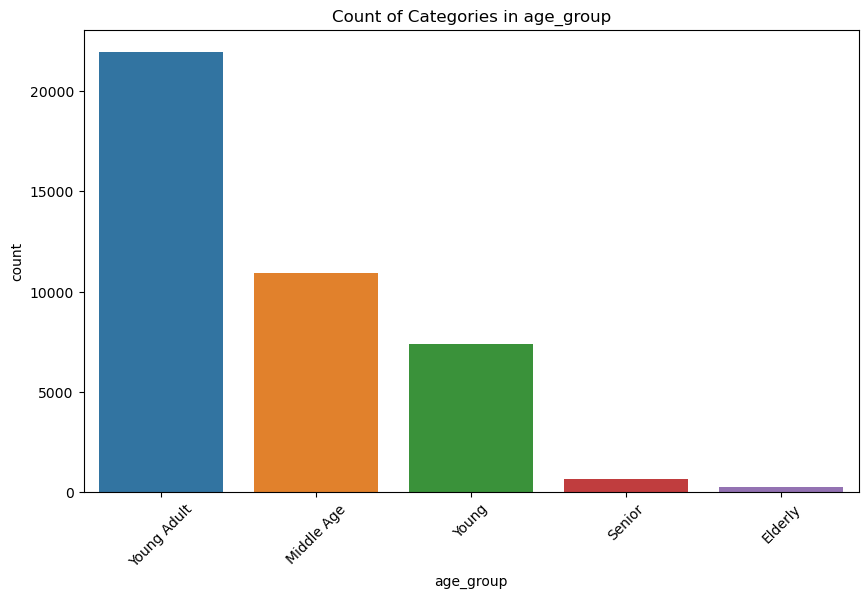

In [119]:
# Visualisation of the distribution of the categorical features
for col in categorical_columns:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=df, x=col, order = df[col].value_counts().index)
    plt.title(f'Count of Categories in {col}')
    plt.xticks(rotation=45)
    plt.show()
    
# (So, 2023)

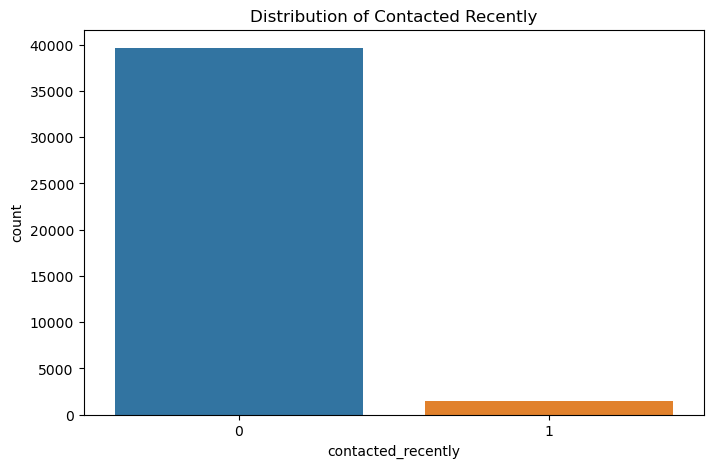

In [120]:
# Distribution of the newly transformed feature
plt.figure(figsize=(8, 5))
sns.countplot(data=df, x='contacted_recently')
plt.title('Distribution of Contacted Recently')
plt.show()

# (So, 2023)

  0%|                                                                                           | 0/76 [00:00<…


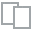
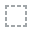
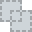
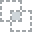
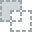
...
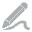
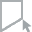
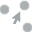
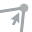
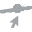

In [121]:
# Create plots for the target variable
from dataprep.eda import plot
plot(df, 'y')

# (Dong, 2023)

### Step 5.2 - Identifiyng Outliers

In [122]:
# Take a quick look over the statistical data of the numerical features again
df.describe()

,duration,campaign,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,contacted_recently,y_binary
count,41168.000000,41168.000000,41168.000000,41168.000000,41168.000000,41168.000000,41168.000000,41168.000000,41168.000000,41168.000000
mean,258.311237,2.568087,0.172756,0.081937,93.575563,-40.502261,3.621425,5167.052308,0.036752,0.112636
std,259.325938,2.770530,0.493782,1.570960,0.578761,4.627020,1.734375,72.230165,0.188154,0.316151
min,0.000000,1.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000,0.000000,0.000000
25%,102.000000,1.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000,0.000000,0.000000
50%,180.000000,2.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000,0.000000,0.000000
75%,319.000000,3.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000,0.000000,0.000000
max,4918.000000,56.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000,1.000000,1.000000


In [123]:
import numpy as np # Library used for numerical calculations

# Initialise an empty dictionary to store the results
outliers_dict = {}

for col in numerical_columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Get count of outliers
    outliers_count = df[(df[col] < lower_bound) | (df[col] > upper_bound)].shape[0]

    # Store the results
    outliers_dict[col] = {
        "Lower_Bound": lower_bound,
        "Upper_Bound": upper_bound,
        "Outliers_Count": outliers_count
    }

# Convert the dictionary to a dataframe for better presentation
outliers_df = pd.DataFrame(outliers_dict).T

print(outliers_df)


                    Lower_Bound  Upper_Bound  Outliers_Count
duration              -223.5000     644.5000          2963.0
campaign                -2.0000       6.0000          2406.0
previous                 0.0000       0.0000          5621.0
emp.var.rate            -6.6000       6.2000             0.0
cons.price.idx          91.6965      95.3725             0.0
cons.conf.idx          -52.1500     -26.9500           446.0
euribor3m               -4.0815      10.3865             0.0
nr.employed           4905.6000    5421.6000             0.0
contacted_recently       0.0000       0.0000          1513.0


#### Visualisations for 5.2 - Identifiyng Outliers

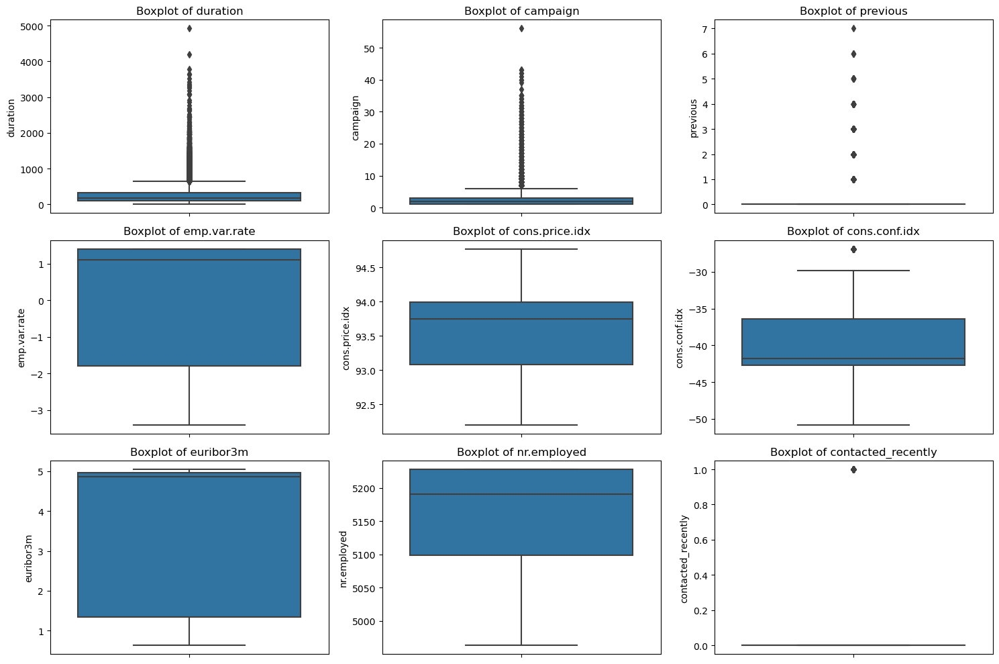

In [124]:
# List of numeric columns where we want to check for outliers
plt.figure(figsize=(15,10))

# Plotting boxplots for each column
for i, col in enumerate(numerical_columns, 1):
    plt.subplot(3, 3, i)
    sns.boxplot(y=df[col])
    plt.ylabel(col)
    plt.title(f'Boxplot of {col}')

plt.tight_layout()
plt.show()


### Key findings from 5.2 Identifiyng Outliers

* Duration: 2963 data points are identified as outliers, despite 75% of the calls lasting less than 319 seconds.
* Campaign: Similarly this feature also has lot of outliers, in total 2406 outliers. The maximum number of contacts performed during this campaign was 56, which is vastly more than 75% of the data which is just 3.
* Previous: Data indicate that a lot of the clients were not contacted prior to the campaign but few of the clients were contacted multiple times.
* Cons.conf.idx: 446 data points fall below the outlier threshold of -52.15 for the consumer confidence index.

Some of the features have a lot of outliers which aligns with the findings from Step 5.1 where a lot of skewed features were discovered. There is no need to immediately handle the identified the outliers but it is important to note that skewed data can have a disproportionate influence on results, leading to potential misinterpretations.

### Step 5.3 - Relationship between variables

#### Relationship Between Variables

In [125]:
# Print the correlation matrix.
# Sort correlations with the binary version of the target variable.
correlation_matrix = df.corr()
print(correlation_matrix)

correlations_with_target = df.corr()['y_binary'].sort_values(ascending=False)
print(correlations_with_target)

# (So, 2023)

                    duration  campaign  previous  emp.var.rate  \
duration            1.000000 -0.071766  0.020642     -0.027924   
campaign           -0.071766  1.000000 -0.079197      0.150817   
previous            0.020642 -0.079197  1.000000     -0.421214   
emp.var.rate       -0.027924  0.150817 -0.421214      1.000000   
cons.price.idx      0.005262  0.127939 -0.204871      0.775615   
cons.conf.idx      -0.008076 -0.013656 -0.049801      0.196103   
euribor3m          -0.032830  0.135199 -0.454910      0.972266   
nr.employed        -0.044627  0.144150 -0.501279      0.907121   
contacted_recently  0.047540 -0.052541  0.587658     -0.270998   
y_binary            0.405328 -0.066343  0.229972     -0.298251   

                    cons.price.idx  cons.conf.idx  euribor3m  nr.employed  \
duration                  0.005262      -0.008076  -0.032830    -0.044627   
campaign                  0.127939      -0.013656   0.135199     0.144150   
previous                 -0.204871      -0

#### Analysis of Categorical Features

In [126]:
# Distribution of target variable across categorical features
for col in categorical_columns:
    print(pd.crosstab(df[col], df['y'], margins=True, margins_name="Total"), "\n")
    
# (So, 2023)

y            no   yes  Total
marital                     
divorced   4134   476   4610
married   22385  2529  24914
single     9944  1620  11564
unknown      68    12     80
Total     36531  4637  41168 

y                       no   yes  Total
education                              
basic.4y              3747   428   4175
basic.6y              2103   188   2291
basic.9y              5571   473   6044
high.school           8479  1031   9510
illiterate              14     4     18
professional.course   4644   594   5238
university.degree    10494  1668  12162
unknown               1479   251   1730
Total                36531  4637  41168 

y           no   yes  Total
default                    
no       28376  4194  32570
unknown   8152   443   8595
yes          3     0      3
Total    36531  4637  41168 

y           no   yes  Total
housing                    
no       16588  2024  18612
unknown    883   107    990
yes      19060  2506  21566
Total    36531  4637  41168 

y           n

In [127]:
# Calculates the average value of the target variable for each categorical feature
for col in categorical_columns:
    print(df.groupby(col)['y_binary'].mean(), "\n")

marital
divorced    0.103254
married     0.101509
single      0.140090
unknown     0.150000
Name: y_binary, dtype: float64 

education
basic.4y               0.102515
basic.6y               0.082060
basic.9y               0.078259
high.school            0.108412
illiterate             0.222222
professional.course    0.113402
university.degree      0.137148
unknown                0.145087
Name: y_binary, dtype: float64 

default
no         0.128769
unknown    0.051542
yes        0.000000
Name: y_binary, dtype: float64 

housing
no         0.108747
unknown    0.108081
yes        0.116201
Name: y_binary, dtype: float64 

loan
no         0.113377
unknown    0.108081
yes        0.109332
Name: y_binary, dtype: float64 

contact
cellular     0.147335
telephone    0.052338
Name: y_binary, dtype: float64 

month
apr    0.204865
aug    0.106056
dec    0.489011
jul    0.090389
jun    0.105115
mar    0.505495
may    0.064375
nov    0.101074
oct    0.439331
sep    0.449123
Name: y_binary, dtype: fl

In [128]:
# Chi-squared tests
from scipy.stats import chi2_contingency # Check if there is a signifcant association between two categorical variables

# (So, 2023)

for col in categorical_columns:
    contingency = pd.crosstab(df[col], df['y'])
    chi2, p, _, _ = chi2_contingency(contingency)
    print(f"Chi-squared test for {col}:")
    print(f"Chi2 Statistic: {chi2}, P-Value: {p}\n")
# (Python: Chi Squared for Categorical Values in Large Dataset, n.d.)

Chi-squared test for marital:
Chi2 Statistic: 123.24250810497784, P-Value: 1.545367250484738e-26

Chi-squared test for education:
Chi2 Statistic: 192.40106144950568, P-Value: 4.659316429321491e-38

Chi-squared test for default:
Chi2 Statistic: 406.1668754932802, P-Value: 6.338458054692336e-89

Chi-squared test for housing:
Chi2 Statistic: 5.764757440253741, P-Value: 0.056001392632042554

Chi-squared test for loan:
Chi2 Statistic: 1.0741024238194457, P-Value: 0.5844691895727654

Chi-squared test for contact:
Chi2 Statistic: 860.8334981810171, P-Value: 3.2089162729521324e-189

Chi-squared test for month:
Chi2 Statistic: 3103.6905347599236, P-Value: 0.0

Chi-squared test for day_of_week:
Chi2 Statistic: 26.033472341587366, P-Value: 3.115661068005872e-05

Chi-squared test for poutcome:
Chi2 Statistic: 4217.65740769466, P-Value: 0.0

Chi-squared test for job:
Chi2 Statistic: 960.0161267578051, P-Value: 7.691135758268049e-199

Chi-squared test for age_group:
Chi2 Statistic: 1310.036621718756

#### Analysis of Numerical Features

In [129]:
# Stats for numerical columns grouped by the target variable 
grouped_stats = df.groupby('y')[numerical_columns].agg(['mean', 'std'])
print(grouped_stats)

# (So, 2023)

       duration              campaign            previous            \
           mean         std      mean       std      mean       std   
y                                                                     
no   220.862719  207.131218  2.633571  2.873951  0.132299  0.408760   
yes  553.336424  401.245018  2.052189  1.666640  0.491482  0.856749   

    emp.var.rate           cons.price.idx           cons.conf.idx            \
            mean       std           mean       std          mean       std   
y                                                                             
no      0.248865  1.482935      93.603691  0.558970    -40.593132  4.390251   
yes    -1.233146  1.623964      93.353968  0.676101    -39.786370  6.136721   

    euribor3m            nr.employed            contacted_recently            
         mean       std         mean        std               mean       std  
y                                                                             
no   3.8115

In [130]:
# T-test
from scipy.stats import ttest_ind # Check if mean of numerical features differ between two groups

print("T-test results for numerical columns:\n")

for col in numerical_columns:
    group_no = df[df['y'] == 'no'][col]
    group_yes = df[df['y'] == 'yes'][col]
    
    t_stat, p = ttest_ind(group_no, group_yes)
    
    print(f"T-test for {col}:")
    print(f"T-statistic: {t_stat}, P-Value: {p}\n")
    
# (So, 2023)
# (Python P-value From T-statistic, n.d.)

T-test results for numerical columns:

T-test for duration:
T-statistic: -89.95966640395275, P-Value: 0.0

T-test for campaign:
T-statistic: 13.490286751781703, P-Value: 2.1850331835872513e-41

T-test for previous:
T-statistic: -47.94505876847229, P-Value: 0.0

T-test for emp.var.rate:
T-statistic: 63.39870878307583, P-Value: 0.0

T-test for cons.price.idx:
T-statistic: 27.938511733640116, P-Value: 3.545038414151215e-170

T-test for cons.conf.idx:
T-statistic: -11.201308141760773, P-Value: 4.426471223158027e-29

T-test for euribor3m:
T-statistic: 65.59994497937804, P-Value: 0.0

T-test for nr.employed:
T-statistic: 76.92946728921919, P-Value: 0.0

T-test for contacted_recently:
T-statistic: -69.59967481638431, P-Value: 0.0



#### Visualisation for 5.3 - Relationship between variables

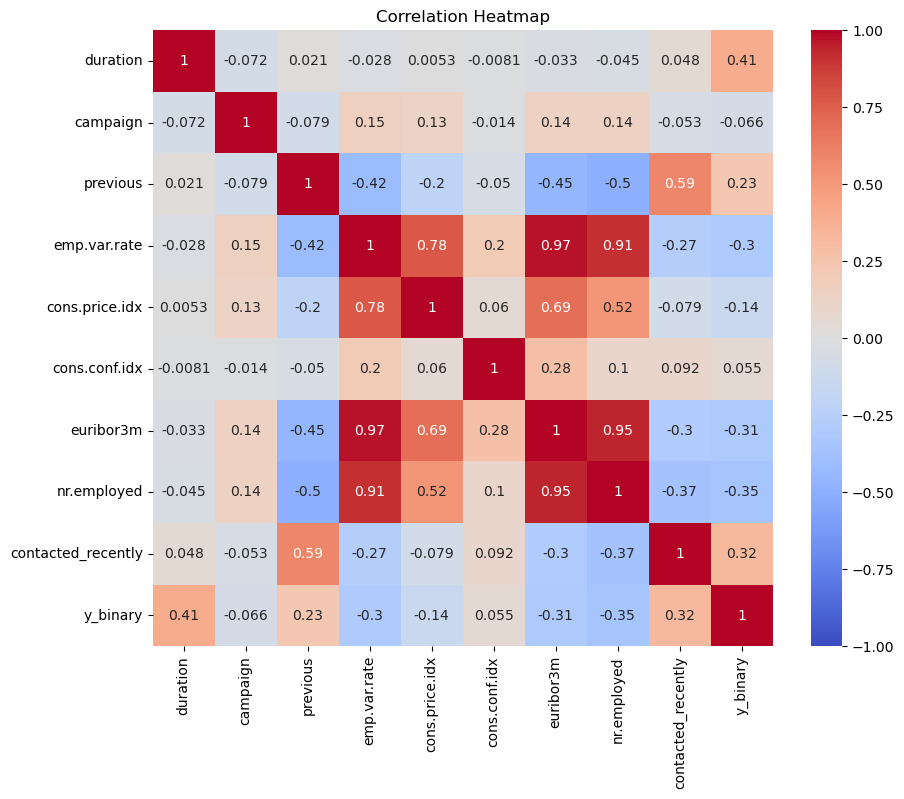

In [131]:
# 1. Heatmap of the Correlation Matrix
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title("Correlation Heatmap")
plt.show()

# (So, 2023)

  0%|                                                                                          | 0/226 [00:00<…


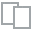
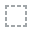
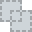
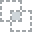
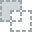
...
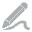
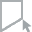
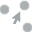
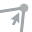
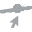

In [132]:
from dataprep.eda import plot_correlation
# Use the plot_correlation function
plot_correlation(df, 'y_binary')

# (So, 2023)

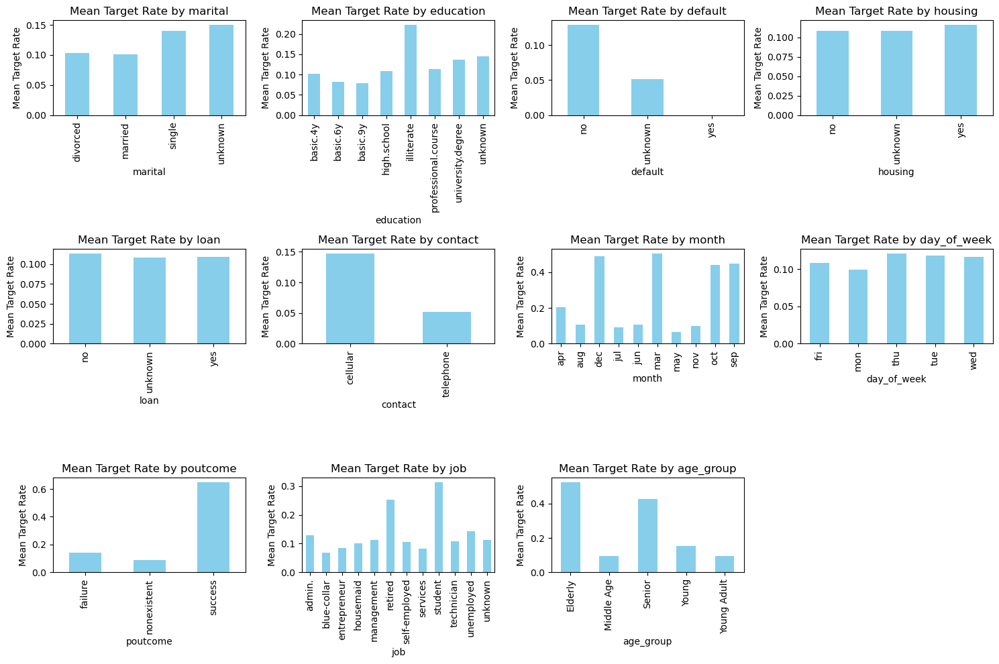

In [133]:
# Bar plots for the average value of the target variable for each categorical feature
plt.figure(figsize=(15, 10))
for index, col in enumerate(categorical_columns, 1):
    plt.subplot(3, 4, index)
    df.groupby(col)['y_binary'].mean().plot(kind='bar', color='skyblue')
    plt.ylabel('Mean Target Rate')
    plt.title(f"Mean Target Rate by {col}")
    plt.tight_layout()

plt.show()

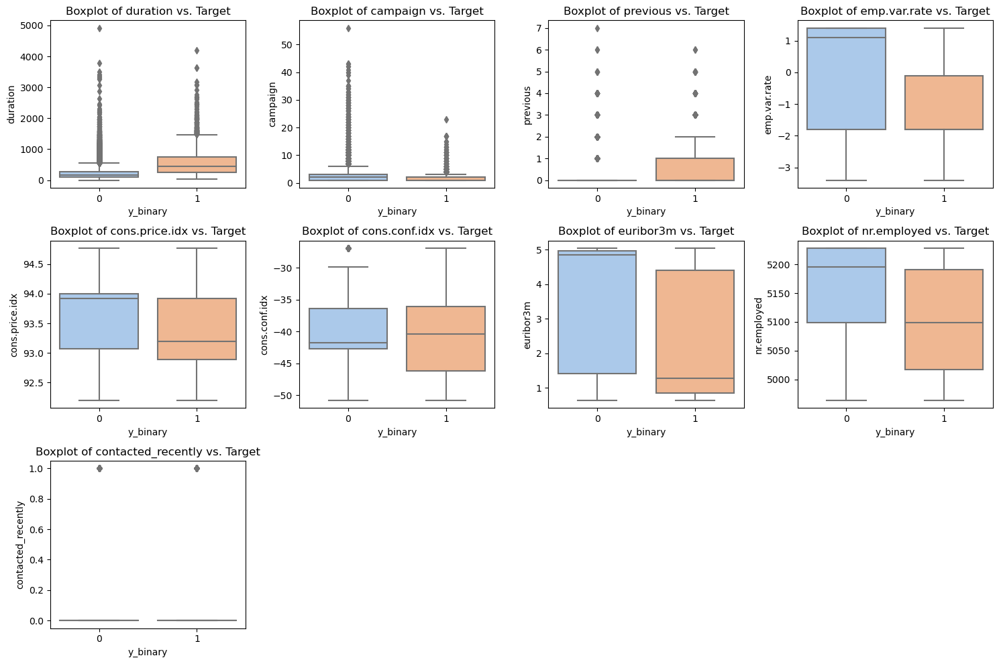

In [134]:
# Box Plots for numeric features compared to the target variable
numeric_columns = df.select_dtypes(include=['float64', 'int64']).columns.drop('y_binary').tolist() # Make new column without binary version
plt.figure(figsize=(15, 10))
for index, col in enumerate(numeric_columns, 1):
    plt.subplot(3, 4, index)
    sns.boxplot(x="y_binary", y=col, data=df, palette='pastel')
    plt.title(f"Boxplot of {col} vs. Target")
    plt.tight_layout()

plt.show()

### Key findings from 5.3 Relationship between variables


1. Categorical Features
* Month: March and December have notably high success rates in the target variable, while May has the highest count but a lower success rate.
* Previous outcome: 'success' has a significantly higher positive outcome for the target variable.
* Job type: Students and the retired have relatively higher positive responses compared to other job categories.
* Age groups: The Elderly and Senior groups have significantly higher positive response rates compared to other age groups.

1. Numerical features
* Duration: has the highest positive correlation (0.405328) with the target variable.
* Contacted_recently and Previous: These features have a decent positive correlation, 0.324474 and 0.229972 respectively.
* nr.employed, euribor3m, and emp.var.rate: Have notable negative correlations with values -0.354532, -0.307641, and -0.298251 respectively.
